In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pandas import read_csv
from ydata_profiling import ProfileReport
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler, OrdinalEncoder, OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.metrics import classification_report
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.linear_model import LogisticRegression, LinearRegression
import lightgbm as lgb
from sklearn import svm
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from lazypredict.Supervised import LazyClassifier, LazyRegressor
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_selection import SelectKBest, chi2, SelectPercentile
from imblearn.over_sampling import RandomOverSampler, SMOTE, SMOTEN
from imblearn.under_sampling import RandomUnderSampler
import re
from sklearn.decomposition import PCA
from sklearn.metrics import roc_curve, auc

In [2]:
df = pd.read_csv('insurance_claims.csv')

In [3]:
to_drop = [
    'policy_number',
    'policy_bind_date',
    'insured_zip',
    'incident_date', 
    'incident_location',
    'incident_hour_of_the_day',
    'auto_model',
    'auto_year',
    '_c39'
]

df = df.drop(to_drop, axis = 1)

In [4]:
df.replace('?', np.nan, inplace = True)

In [5]:
to_drop = [
    'property_damage',
    'police_report_available'
]

df = df.drop(to_drop, axis = 1)

In [6]:
for col in df.columns:
    if df[col].dtype in [np.float64, np.int64]:  
        median_val = df[col].median()
        df[col].fillna(median_val, inplace=True)
    else: 
        mode_val = df[col].mode()[0]   
        df[col].fillna(mode_val, inplace=True)

In [7]:
df['insured_hobbies']=df['insured_hobbies'].apply(lambda x :'Other' if x!='chess' and x!='cross-fit' else x)

In [8]:
x = df.drop('fraud_reported', axis = 1)
y = df['fraud_reported']

In [9]:
le = LabelEncoder()
y = le.fit_transform(y)

In [10]:
cat_df = x.select_dtypes(include = ['object'])
x.drop(columns = cat_df.columns, inplace = True)

cat_df = pd.get_dummies(cat_df, drop_first = True)
x = pd.concat([cat_df, x], axis = 1)

In [11]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, stratify = y, random_state = 42)

In [12]:
#RUS
# from collections import Counter

# print("Trước khi undersampling:", Counter(y_train))

# ros = RandomUnderSampler(sampling_strategy = {0: 250, 1: 198}, random_state = 42)
# x_train, y_train = ros.fit_resample(x_train, y_train)

# print("Sau khi undersampling:", Counter(y_train))

In [13]:
num = x_train.select_dtypes(include = ['int64', 'float64'])
scaler = StandardScaler()
scaled_num = scaler.fit_transform(num)
scaled_num_df = pd.DataFrame(data = scaled_num, columns = num.columns, index = x_train.index)
x_train.drop(columns = scaled_num_df.columns, inplace = True)
x_train = pd.concat([scaled_num_df, x_train], axis = 1)

In [14]:
num = x_test.select_dtypes(include = ['int64', 'float64'])
scaled_num = scaler.transform(num)
scaled_num_df = pd.DataFrame(data = scaled_num, columns = num.columns, index = x_test.index)
x_test.drop(columns = scaled_num_df.columns, inplace = True)
x_test = pd.concat([scaled_num_df, x_test], axis = 1)

In [15]:
n_components = 0.95

pca = PCA(n_components = n_components)
x_train = pca.fit_transform(x_train)
x_test = pca.transform(x_test)

print(f"Số lượng thành phần được giữ lại: {pca.n_components_}")
print(f"Tỷ lệ phương sai giải thích được: {sum(pca.explained_variance_ratio_):.4f}")

Số lượng thành phần được giữ lại: 53
Tỷ lệ phương sai giải thích được: 0.9502


In [16]:
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import roc_auc_score
from sklearn.neural_network import MLPClassifier
from sklearn.tree import DecisionTreeClassifier 
from sklearn.linear_model import RidgeClassifierCV
from sklearn.dummy import DummyClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.naive_bayes import BernoulliNB
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.linear_model import Perceptron

In [17]:
def AUC(test, proba):
    auc = roc_auc_score(test, proba)
    return round(auc, 2)

In [18]:
class_weight = None

DECISION TREE

In [216]:
model = DecisionTreeClassifier(random_state = 42, class_weight = class_weight)
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
y_proba = model.predict_proba(x_test)[:, 1]
print(classification_report(y_test, y_predict, digits = 2))
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

              precision    recall  f1-score   support

           0       0.84      0.63      0.72       151
           1       0.36      0.63      0.46        49

    accuracy                           0.63       200
   macro avg       0.60      0.63      0.59       200
weighted avg       0.72      0.63      0.66       200

_______________________________________________________________
AUC = 0.63


In [203]:
param_grid = {
    "criterion": ["gini", "entropy", "log_loss"],   # tiêu chí chia nhánh
    "max_depth": [None, 3, 5, 10, 20, 30],          # độ sâu cây
    "min_samples_split": [2, 5, 10, 20],            # số mẫu tối thiểu để chia một node
    "min_samples_leaf": [1, 2, 5, 10],              # số mẫu tối thiểu tại một lá
    "max_features": [None, "sqrt", "log2"],         # số lượng đặc trưng khi chia
}

grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = 'accuracy', cv = 4, verbose = 1)
grid.fit(x_train, y_train)
y_predict = grid.predict(x_test)
print(grid.best_params_)
print(grid.best_score_)
print(classification_report(y_test, y_predict, digits = 2))

best_model = grid.best_estimator_
print(best_model)
best_model.fit(x_train, y_train)
y_proba = best_model.predict_proba(x_test)[:, 1]
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

Fitting 4 folds for each of 864 candidates, totalling 3456 fits
{'criterion': 'entropy', 'max_depth': 5, 'max_features': None, 'min_samples_leaf': 10, 'min_samples_split': 2}
0.6361607142857142
              precision    recall  f1-score   support

           0       0.82      0.64      0.72       151
           1       0.34      0.57      0.42        49

    accuracy                           0.62       200
   macro avg       0.58      0.60      0.57       200
weighted avg       0.70      0.62      0.64       200

DecisionTreeClassifier(criterion='entropy', max_depth=5, min_samples_leaf=10,
                       random_state=42)
_______________________________________________________________
AUC = 0.61


RANDOM FOREST CLASSIFIER

              precision    recall  f1-score   support

           0       0.77      1.00      0.87       151
           1       1.00      0.06      0.12        49

    accuracy                           0.77       200
   macro avg       0.88      0.53      0.49       200
weighted avg       0.82      0.77      0.68       200

_______________________________________________________________
AUC = 0.8


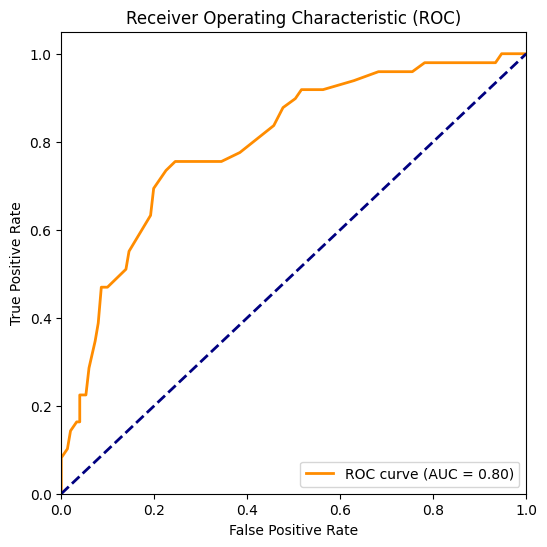

[ inf 0.54 0.49 0.48 0.47 0.46 0.45 0.44 0.43 0.42 0.41 0.4  0.39 0.38
 0.37 0.35 0.34 0.33 0.32 0.31 0.3  0.29 0.28 0.27 0.26 0.25 0.24 0.23
 0.22 0.21 0.2  0.19 0.18 0.17 0.16 0.15 0.14 0.13 0.12 0.11 0.1  0.09
 0.08 0.07]


In [19]:
model = RandomForestClassifier(random_state = 42, class_weight = class_weight)
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
y_proba = model.predict_proba(x_test)[:, 1]
print(classification_report(y_test, y_predict, digits = 2))
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))


fpr, tpr, thresholds = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

# Vẽ đồ thị
plt.figure(figsize=(6,6))
plt.plot(fpr, tpr, color='darkorange', lw=2,
         label='ROC curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')  # đường chéo tham chiếu
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

print(thresholds)

In [205]:
param_grid = {
    "n_estimators": [200, 500, 800],
    "max_depth": [None, 10, 20, 30],
    "min_samples_split": [2, 5, 10, 20],
    "min_samples_leaf": [1, 2, 4, 8],
    "max_features": ["sqrt", "log2"],  # 0.5 = dùng 50% số đặc trưng
    "bootstrap": [True],
    "max_samples": [None, 0.8]
}

grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = 'accuracy', cv = 4, verbose = 1)
grid.fit(x_train, y_train)
y_predict = grid.predict(x_test)
print(grid.best_params_)
print(grid.best_score_)
print(classification_report(y_test, y_predict, digits = 2))

best_model = grid.best_estimator_
print(best_model)
best_model.fit(x_train, y_train)
y_proba = best_model.predict_proba(x_test)[:, 1]
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

Fitting 4 folds for each of 768 candidates, totalling 3072 fits
{'bootstrap': True, 'max_depth': None, 'max_features': 'sqrt', 'max_samples': 0.8, 'min_samples_leaf': 1, 'min_samples_split': 10, 'n_estimators': 800}
0.7455357142857142
              precision    recall  f1-score   support

           0       0.82      0.83      0.82       151
           1       0.45      0.43      0.44        49

    accuracy                           0.73       200
   macro avg       0.63      0.63      0.63       200
weighted avg       0.73      0.73      0.73       200

RandomForestClassifier(max_samples=0.8, min_samples_split=10, n_estimators=800,
                       random_state=42)
_______________________________________________________________
AUC = 0.73


RIDGE CLASSIFIER CV

In [206]:
model = RidgeClassifierCV(class_weight = class_weight)
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
y_proba = model.decision_function(x_test)
print(classification_report(y_test, y_predict, digits = 2))
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

              precision    recall  f1-score   support

           0       0.87      0.82      0.84       151
           1       0.53      0.61      0.57        49

    accuracy                           0.77       200
   macro avg       0.70      0.72      0.70       200
weighted avg       0.78      0.77      0.78       200

_______________________________________________________________
AUC = 0.77


In [207]:
param_grid = {
    "alphas": [
        [0.1, 1, 10],
        [1, 10, 100],
        [0.01, 0.1, 1, 10, 100]
    ],
    "fit_intercept": [True, False],
}

grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = 'accuracy', cv = 4, verbose = 1)
grid.fit(x_train, y_train)
y_predict = grid.predict(x_test)
print(grid.best_params_)
print(grid.best_score_)
print(classification_report(y_test, y_predict, digits = 2))

best_model = grid.best_estimator_
print(best_model)
best_model.fit(x_train, y_train)
y_proba = best_model.decision_function(x_test)
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

Fitting 4 folds for each of 6 candidates, totalling 24 fits
{'alphas': [0.1, 1, 10], 'fit_intercept': True}
0.7589285714285714
              precision    recall  f1-score   support

           0       0.87      0.82      0.84       151
           1       0.53      0.61      0.57        49

    accuracy                           0.77       200
   macro avg       0.70      0.72      0.70       200
weighted avg       0.78      0.77      0.78       200

RidgeClassifierCV(alphas=[0.1, 1, 10])
_______________________________________________________________
AUC = 0.77


LOGISTIC REGRESSION

In [208]:
model = LogisticRegression(random_state = 42, class_weight = class_weight)
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
y_proba = model.predict_proba(x_test)[:, 1]
print(classification_report(y_test, y_predict, digits = 2))
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

              precision    recall  f1-score   support

           0       0.86      0.81      0.84       151
           1       0.51      0.59      0.55        49

    accuracy                           0.76       200
   macro avg       0.68      0.70      0.69       200
weighted avg       0.77      0.76      0.77       200

_______________________________________________________________
AUC = 0.76


In [209]:
param_grid = [
    {
        "solver": ["lbfgs", "newton-cg", "sag"],
        "penalty": ["l2"],
        "C": [0.01, 0.1, 1, 10, 100],
        "fit_intercept": [True, False],
        "multi_class": ["ovr", "multinomial"],
        "max_iter": [500, 1000]
    },
    {
        "solver": ["liblinear"],
        "penalty": ["l1", "l2"],
        "C": [0.01, 0.1, 1, 10, 100],
        "fit_intercept": [True, False],
        "multi_class": ["ovr"],
        "max_iter": [500, 1000]
    },
    {
        "solver": ["saga"],
        "penalty": ["l1", "l2", "elasticnet"],
        "C": [0.01, 0.1, 1, 10, 100],
        "l1_ratio": [0.1, 0.3, 0.5, 0.7, 0.9],  # dùng khi elasticnet
        "fit_intercept": [True, False],
        "multi_class": ["ovr", "multinomial"],
        "max_iter": [500, 1000]
    }
]


grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = 'accuracy', cv = 4, verbose = 1)
grid.fit(x_train, y_train)
y_predict = grid.predict(x_test)
print(grid.best_params_)
print(grid.best_score_)
print(classification_report(y_test, y_predict, digits = 2))

best_model = grid.best_estimator_
print(best_model)
best_model.fit(x_train, y_train)
y_proba = best_model.predict_proba(x_test)[:, 1]
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

Fitting 4 folds for each of 760 candidates, totalling 3040 fits
{'C': 0.1, 'fit_intercept': False, 'max_iter': 500, 'multi_class': 'multinomial', 'penalty': 'l2', 'solver': 'lbfgs'}
0.7589285714285715
              precision    recall  f1-score   support

           0       0.87      0.70      0.78       151
           1       0.42      0.67      0.52        49

    accuracy                           0.69       200
   macro avg       0.65      0.69      0.65       200
weighted avg       0.76      0.69      0.71       200

LogisticRegression(C=0.1, fit_intercept=False, max_iter=500,
                   multi_class='multinomial', random_state=42)
_______________________________________________________________
AUC = 0.76


SVC

In [210]:
model = svm.SVC(random_state = 42, class_weight = class_weight)
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
y_proba = model.decision_function(x_test)
print(classification_report(y_test, y_predict, digits = 2))
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

              precision    recall  f1-score   support

           0       0.83      0.81      0.82       151
           1       0.45      0.49      0.47        49

    accuracy                           0.73       200
   macro avg       0.64      0.65      0.64       200
weighted avg       0.74      0.73      0.73       200

_______________________________________________________________
AUC = 0.71


In [211]:
param_grid = [
    {
        "kernel": ["rbf"],
        "C": [0.01, 0.1, 1, 10, 100, 1000],
        "gamma": ["scale", "auto", 0.001, 0.01, 0.1, 1],
        "shrinking": [True, False],
    },
    {
        "kernel": ["linear"],
        "C": [0.001, 0.01, 0.1, 1, 10, 100, 1000],
        "shrinking": [True, False],
    },
    {
        "kernel": ["poly"],
        "C": [0.01, 0.1, 1, 10, 100],
        "degree": [2, 3, 4, 5],
        "gamma": ["scale", "auto", 0.001, 0.01, 0.1],
        "coef0": [0.0, 0.5, 1.0],
        "shrinking": [True, False],
    },
    {
        "kernel": ["sigmoid"],
        "C": [0.01, 0.1, 1, 10, 100],
        "gamma": ["scale", "auto", 0.001, 0.01, 0.1],
        "coef0": [0.0, 0.5, 1.0],
        "shrinking": [True, False],
    },
]
grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = 'accuracy', cv = 4, verbose = 2)
grid.fit(x_train, y_train)
y_predict = grid.predict(x_test)
print(grid.best_params_)
print(grid.best_score_)
print(classification_report(y_test, y_predict, digits = 2))

best_model = grid.best_estimator_
print(best_model)
best_model.fit(x_train, y_train)
y_proba = best_model.decision_function(x_test)
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

Fitting 4 folds for each of 836 candidates, totalling 3344 fits
[CV] END ....C=0.01, gamma=scale, kernel=rbf, shrinking=True; total time=   0.0s
[CV] END ....C=0.01, gamma=scale, kernel=rbf, shrinking=True; total time=   0.0s
[CV] END ....C=0.01, gamma=scale, kernel=rbf, shrinking=True; total time=   0.0s
[CV] END ....C=0.01, gamma=scale, kernel=rbf, shrinking=True; total time=   0.0s
[CV] END ...C=0.01, gamma=scale, kernel=rbf, shrinking=False; total time=   0.0s
[CV] END ...C=0.01, gamma=scale, kernel=rbf, shrinking=False; total time=   0.0s
[CV] END ...C=0.01, gamma=scale, kernel=rbf, shrinking=False; total time=   0.0s
[CV] END ...C=0.01, gamma=scale, kernel=rbf, shrinking=False; total time=   0.0s
[CV] END .....C=0.01, gamma=auto, kernel=rbf, shrinking=True; total time=   0.0s
[CV] END .....C=0.01, gamma=auto, kernel=rbf, shrinking=True; total time=   0.0s
[CV] END .....C=0.01, gamma=auto, kernel=rbf, shrinking=True; total time=   0.0s
[CV] END .....C=0.01, gamma=auto, kernel=rbf,

XGBCLASSIFIER

In [212]:
model = XGBClassifier(random_state = 42, class_weight = class_weight)
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
y_proba = model.predict_proba(x_test)[:, 1]
print(classification_report(y_test, y_predict, digits = 2))
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

              precision    recall  f1-score   support

           0       0.85      0.72      0.78       151
           1       0.41      0.61      0.49        49

    accuracy                           0.69       200
   macro avg       0.63      0.66      0.63       200
weighted avg       0.74      0.69      0.71       200

_______________________________________________________________
AUC = 0.73


In [213]:
param_grid = {
    'n_estimators': [100, 200],          # số lượng cây boosting
    'max_depth': [3, 5, 7],                  # độ sâu tối đa của cây
    'learning_rate': [0.01, 0.1],       # tốc độ học (eta)
    'subsample': [0.7, 0.8],            # tỷ lệ mẫu dùng cho mỗi cây
    'colsample_bytree': [0.8, 1.0],     # tỷ lệ cột (features) dùng cho mỗi cây
    'gamma': [0, 0.1],                  # độ phạt khi thêm node mới (regularization)
    'reg_lambda': [1, 1.5],               # L2 regularization
    'reg_alpha': [0, 0.1]               # L1 regularization
}


grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = 'accuracy', cv = 4, verbose = 1)
grid.fit(x_train, y_train)
y_predict = grid.predict(x_test)
print(grid.best_params_)
print(grid.best_score_)
print(classification_report(y_test, y_predict, digits = 2))

best_model = grid.best_estimator_
print(best_model)
best_model.fit(x_train, y_train)
y_proba = best_model.predict_proba(x_test)[:, 1]
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

Fitting 4 folds for each of 384 candidates, totalling 1536 fits
{'colsample_bytree': 1.0, 'gamma': 0.1, 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'reg_alpha': 0.1, 'reg_lambda': 1, 'subsample': 0.7}
0.7544642857142858
              precision    recall  f1-score   support

           0       0.86      0.79      0.82       151
           1       0.48      0.59      0.53        49

    accuracy                           0.74       200
   macro avg       0.67      0.69      0.67       200
weighted avg       0.76      0.74      0.75       200

XGBClassifier(base_score=None, booster=None, callbacks=None, class_weight=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=1.0, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0.1, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,


LIGHTGBM

In [214]:
model = LGBMClassifier(random_state = 42, class_weight = class_weight)
model.fit(x_train, y_train)
y_predict = model.predict(x_test)
y_proba = model.predict_proba(x_test)[:, 1]
print(classification_report(y_test, y_predict, digits = 2))
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

[LightGBM] [Info] Number of positive: 198, number of negative: 250
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000846 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10334
[LightGBM] [Info] Number of data points in the train set: 448, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.441964 -> initscore=-0.233194
[LightGBM] [Info] Start training from score -0.233194
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

In [215]:
param_grid = {
    'n_estimators': [100, 200],          # số lượng cây boosting
    'max_depth': [3, 5, 7],                  # độ sâu tối đa của cây
    'learning_rate': [0.01, 0.1],       # tốc độ học (eta)
    'subsample': [0.7, 0.8],            # tỷ lệ mẫu dùng cho mỗi cây
    'colsample_bytree': [0.7, 0.8],     # tỷ lệ cột (features) dùng cho mỗi cây
    'gamma': [0, 0.1],                  # độ phạt khi thêm node mới (regularization)
    'reg_lambda': [1, 1.5],               # L2 regularization
    'reg_alpha': [0, 0.1]               # L1 regularization
}


grid = GridSearchCV(estimator = model, param_grid = param_grid, scoring = 'accuracy', cv = 4, verbose = 0)
grid.fit(x_train, y_train)
y_predict = grid.predict(x_test)
print(grid.best_params_)
print(grid.best_score_)
print(classification_report(y_test, y_predict, digits = 2))

best_model = grid.best_estimator_
print(best_model)
best_model.fit(x_train, y_train)
y_proba = model.predict_proba(x_test)[:, 1]
print('_______________________________________________________________')
print('AUC =', AUC(y_test, y_proba))

[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Warning] Unknown parameter: gamma
[LightGBM] [Info] Number of positive: 149, number of negative: 187
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000591 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 7797
[LightGBM] [Info] Number of data points in the train set: 336, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.443452 -> initscore=-0.227162
[LightGBM] [Info] Start training from score -0.227162
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p